In [67]:
from diabetic_retinopathy.latent_extractors.predictors.NNExtractor import NNExtractor
from diabetic_retinopathy.latent_extractors.predictors.utils import (
    Stage,
    FinishCallback,
    NNModel,
)
from diabetic_retinopathy.constants import MODELS_DIR, RESULTS_DIR, PhaseType
from diabetic_retinopathy.latent_extractors.predictors.models.LatentExtractor import (
    Models,
    get_latent_extractor,
)
from diabetic_retinopathy.latent_extractors.predictors.models.BaseExtractor import (
    BaseExtractor,
)

from diabetic_retinopathy.latent_extractors.predictors.opts import ModelOptions

from diabetic_retinopathy.constants import RESULTS_DIR, PhaseType, DATASPLIT_DIR
from pathlib import Path

from diabetic_retinopathy.cli.predict_cli import (
    setup_cli_params,
    ModelPredictor,
    get_model_path,
)

In [106]:
OPTIONS = "--phase test --model_names resnet18ImgNetFC-version3 --batch_size 64 --models_for_inference all --include_unfinished True  --which_checkpoint best"

In [107]:
!python -u /dss/dsshome1/02/di93zov/Projects/ehrapy_DR_latents/ehrapy_latents/ehrapylat/cli/cmdline.py predict $OPTIONS

predicting  resnet18ImgNetFC-version3, all models, predictions for following models will be acquired: [{'model_name': 'resnet18ImgNetFC-version3'}]
Predicting from resnet18ImgNetFC-version3
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/pytorch_lightning/utilities/parsing.py:197

In [1]:
from ehrapylat.constants import label_map, RESULTS_DIR
from pathlib import Path
import pandas as pd

In [2]:
from sklearn.metrics import (
    classification_report,
    mean_squared_error,
    mean_absolute_error,
    confusion_matrix,
    ConfusionMatrixDisplay,
)


def classification_result_from_preds(t):
    res = classification_report(
        t.gt_class_decoded.values, t.predicted_class_decoded.values, output_dict=True
    )
    # print(res.keys())
    res_rows = []
    for metric in ["f1-score", "precision", "recall"]:
        for response_type in [
            el for el in label_map.values() if el in list(res.keys())
        ]:
            # print(res[response_type])
            res_row = pd.DataFrame.from_records(
                [
                    {
                        "metric": metric,
                        "response_type": response_type,
                        "value": res[response_type][metric],
                    }
                ]
            )
            res_rows.append(res_row)

        for avg in ["weighted avg", "macro avg"]:
            res_row = pd.DataFrame.from_records(
                [{"metric": metric, "response_type": avg, "value": res[avg][metric]}]
            )

            res_rows.append(res_row)

    res_pd = pd.concat(res_rows, ignore_index=True)
    return res_pd

In [14]:
def get_preds_result(phase="test"):
    trainable_fc_models = [
        path.resolve().parent for path in Path(RESULTS_DIR).rglob("class_predictions")
    ]
    experiments = []
    predictions = {}
    classification_results = []

    for experiment_path in trainable_fc_models[:]:
        for ckptn in ["last", "best"]:
            res_path = (
                experiment_path / "class_predictions" / ckptn / f"{phase}_preds.csv"
            )
            if res_path.exists():
                row = dict(
                    model_path=experiment_path,
                    experiment=f"{experiment_path.name}-{ckptn}",
                    model_name=experiment_path.name,
                    ckptn=ckptn,
                )
                experiments.append(row)
                pred_pd = pd.read_csv(res_path)
                predictions[row["experiment"]] = pred_pd
                cl_res = classification_result_from_preds(pred_pd)
                cl_res["experiment"] = row["experiment"]
                classification_results.append(cl_res)

    # display(cl_res)
    experiments_pd = pd.DataFrame.from_records(experiments)
    classification_results = pd.concat(classification_results, ignore_index=True)

    return experiments_pd, predictions, classification_results

In [15]:
def get_ordered_df(cl_pd, labels):
    def condense_cl_group(group, metric="f1-score", labels=None):
        res_row = dict(experiment=group.experiment.iloc[0])
        for response_type in labels:
            gr_ = group[group.metric == metric]
            if response_type in gr_.response_type.values:
                res_row[f"{metric}_{response_type}"] = gr_[
                    gr_.response_type == labels
                ].value.iloc[0]
            else:
                print(f"type {response_type} not present in df")
        return pd.DataFrame.from_dict([res_row])

    cl_metrics = ["f1-score", "precision", "recall"]
    # display(cl_pd)

    for metric in cl_pd.metric.unique():
        response_types_avg_ = (
            ["macro avg", "weighted avg"] if metric in cl_metrics else ["all"]
        )
        cl_pd_m = cl_pd[(cl_pd["metric"] == metric)]
        response_types_ = cl_pd_m.response_type.unique()

        cl_group_condensed = cl_pd_m.groupby(["experiment"], as_index=False).apply(
            lambda gr: condense_cl_group(gr, metric=metric, labels=response_types_)
        )

        # sort_el_list = response_types_avg_+response_types
        for sort_el in response_types_:
            sorted_values = (
                [f"{metric}_{sort_el}"]
                + [
                    f"{metric}_{el}"
                    for el in response_types_avg_
                    if el != sort_el and el in response_types_
                ]
                + [
                    f"{metric}_{el}"
                    for el in labels
                    if el != sort_el and el in response_types_
                ]
            )
            cl_group_condensed = cl_group_condensed.sort_values(
                sorted_values, ascending=False, ignore_index=True
            )

            cl_group_condensed.reset_index(inplace=True)
            cl_group_condensed = cl_group_condensed.rename(
                columns={"index": f"order_{metric}_{sort_el}"}
            )

        cl_pd = cl_pd.merge(
            cl_group_condensed[
                ["experiment"]
                + [f"order_{metric}_{sort_el}" for sort_el in response_types_]
                + [f"{metric}_{resp}" for resp in response_types_]
            ],
            on="experiment",
            how="left",
        )

    return cl_pd

In [16]:
experiments_pd, predictions, classification_results = get_preds_result()

/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(av

In [17]:
experiments_pd

,model_path,experiment,model_name,ckptn
0,/dss/dssfs02/lwp-dss-0001/pn36po/pn36po-dss-00...,resnet18ActBasedFC-version3-last,resnet18ActBasedFC-version3,last
1,/dss/dssfs02/lwp-dss-0001/pn36po/pn36po-dss-00...,resnet18ActBasedFC-version3-best,resnet18ActBasedFC-version3,best
2,/dss/dssfs02/lwp-dss-0001/pn36po/pn36po-dss-00...,resnet50KaggleFC-version0-last,resnet50KaggleFC-version0,last
3,/dss/dssfs02/lwp-dss-0001/pn36po/pn36po-dss-00...,resnet50KaggleFC-version0-best,resnet50KaggleFC-version0,best
4,/dss/dssfs02/lwp-dss-0001/pn36po/pn36po-dss-00...,resnet18ActBasedFC-version1-last,resnet18ActBasedFC-version1,last
5,/dss/dssfs02/lwp-dss-0001/pn36po/pn36po-dss-00...,resnet18ActBasedFC-version1-best,resnet18ActBasedFC-version1,best
6,/dss/dssfs02/lwp-dss-0001/pn36po/pn36po-dss-00...,resnet18ImgNetFC-version2-last,resnet18ImgNetFC-version2,last
7,/dss/dssfs02/lwp-dss-0001/pn36po/pn36po-dss-00...,resnet18ImgNetFC-version2-best,resnet18ImgNetFC-version2,best
8,/dss/dssfs02/lwp-dss-0001/pn36po/pn36po-dss-00...,resnet18RawFC-version2-last,resnet18RawFC-version2,last
9,/dss/dssfs02/lwp-dss-0001/pn36po/pn36po-dss-00...,resnet18RawFC-version2-best,resnet18RawFC-version2,best


In [18]:
classification_results_ordered = get_ordered_df(
    classification_results, labels=list(label_map.values())
)

In [19]:
classification_results_ordered.experiment.unique()

array(['resnet18ActBasedFC-version3-last',
       'resnet18ActBasedFC-version3-best',
       'resnet50KaggleFC-version0-last', 'resnet50KaggleFC-version0-best',
       'resnet18ActBasedFC-version1-last',
       'resnet18ActBasedFC-version1-best',
       'resnet18ImgNetFC-version2-last', 'resnet18ImgNetFC-version2-best',
       'resnet18RawFC-version2-last', 'resnet18RawFC-version2-best',
       'resnet18ImgNetFC-version0-last', 'resnet18ImgNetFC-version0-best',
       'resnet18RawFC-version0-last', 'resnet18RawFC-version0-best',
       'resnet18ActBasedFC-version0-last',
       'resnet18ActBasedFC-version0-best', 'resnet18RawFC-version1-last',
       'resnet18RawFC-version1-best', 'resnet18ImgNetFC-version3-last',
       'resnet18ImgNetFC-version3-best'], dtype=object)

resnet18ImgNetFC-version2-best


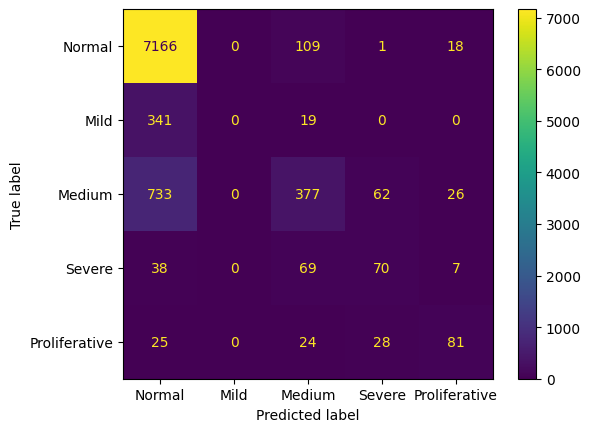

In [20]:
experiment_name = classification_results_ordered[
    classification_results_ordered["order_f1-score_macro avg"] == 0
].experiment.unique()[0]

# experiment_name= 'resnet18ImgNetFC-version3-last'
print(experiment_name)
preds = predictions[experiment_name]
labels = [
    el for el in label_map.values() if el in list(preds.gt_class_decoded.unique())
]
cm = confusion_matrix(
    preds.gt_class_decoded.values.ravel(),
    preds.predicted_class_decoded.values.ravel(),
    labels=labels,
)
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels).plot()

resnet18ImgNetFC-version3-best


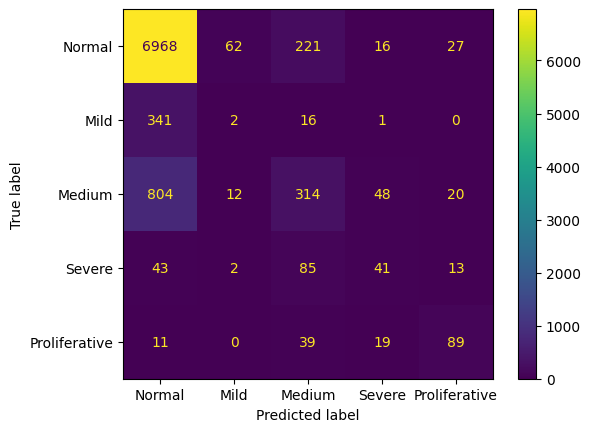

In [21]:
# experiment_name = classification_results_ordered[classification_results_ordered['order_f1-score_macro avg']==0].experiment.unique()[0]

experiment_name = "resnet18ImgNetFC-version3-best"
print(experiment_name)
preds = predictions[experiment_name]
labels = [
    el for el in label_map.values() if el in list(preds.gt_class_decoded.unique())
]
cm = confusion_matrix(
    preds.gt_class_decoded.values.ravel(),
    preds.predicted_class_decoded.values.ravel(),
    labels=labels,
)
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels).plot()

In [22]:
import scanpy as sc
import pandas as pd
import scvelo as scv
import cellrank as cr
import ehrapy as ep
import numpy as np
import matplotlib.pyplot as plt
import ehrapy as ep

In [23]:
from ehrapylat.latent_extractors.predictors.utils import Stage, FinishCallback, NNModel
from ehrapylat.constants import MODELS_DIR, RESULTS_DIR
from ehrapylat.latent_extractors.predictors.models.LatentExtractor import (
    Models as SpatialSSLModels,
)

# from ehrapylat.latent_extractors.predictors.utils import Stage

In [24]:
palette = {
    "Normal": "yellowgreen",
    "Mild": "darkorange",
    "Medium": "mediumturquoise",
    "Severe": "red",
    "Proliferative": "purple",
}

In [89]:
adata_dicts = {}
ignored_models = [
    "resnet18ActBasedFC-version0",
    "resnet18RawFC-version0",
    "resnet18ImgNetFC-version0",
    "resnet18RawFC-version2",
]

for i, row in experiments_pd.iterrows():
    filepath = RESULTS_DIR / row.model_name / "latents" / row.ckptn / "latents-test.csv"
    if filepath.exists() and row.model_name not in ignored_models:

        columns_obs_only_ = ["gt_class", "gt_class_decoded"]
        id_col = "id"

        adata_dicts[f"{row.experiment}"] = ep.io.read_csv(
            filepath, index_column=id_col, columns_obs_only=columns_obs_only_
        )
    # print()
    else:
        print(filepath.exists(), filepath)

2023-06-17 20:14:10,681 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `9194` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:14:10,811 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `9194` x `64`.
2023-06-17 20:14:10,988 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `9194` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:14:11,155 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `9194` x `64`.
2023-06-17 20:14:11,315 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `9194` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:14:11,476 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `9194` x `64`.
2023-06-17 20:14:11,628 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `9194` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:14:11,777 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `9194` x `64`.
2023-06-17 20:14:11,899 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `9194` x `64`.
2023-06-17 20:14:12,020 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `9194` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


True /dss/dsshome1/02/di93zov/Projects/ehrapy_DR_latents/ehrapy_latents/project_folder/results/resnet18ImgNetFC-version0/latents/last/latents-test.csv
True /dss/dsshome1/02/di93zov/Projects/ehrapy_DR_latents/ehrapy_latents/project_folder/results/resnet18ImgNetFC-version0/latents/best/latents-test.csv
True /dss/dsshome1/02/di93zov/Projects/ehrapy_DR_latents/ehrapy_latents/project_folder/results/resnet18RawFC-version0/latents/last/latents-test.csv
True /dss/dsshome1/02/di93zov/Projects/ehrapy_DR_latents/ehrapy_latents/project_folder/results/resnet18RawFC-version0/latents/best/latents-test.csv
True /dss/dsshome1/02/di93zov/Projects/ehrapy_DR_latents/ehrapy_latents/project_folder/results/resnet18ActBasedFC-version0/latents/last/latents-test.csv
True /dss/dsshome1/02/di93zov/Projects/ehrapy_DR_latents/ehrapy_latents/project_folder/results/resnet18ActBasedFC-version0/latents/best/latents-test.csv
2023-06-17 20:14:12,170 - root INFO - Transformed passed dataframe into an AnnData object with n

/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:14:12,315 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `9194` x `64`.
2023-06-17 20:14:12,459 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `9194` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:14:12,607 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `9194` x `64`.


In [90]:
def show_adata(adata, palette=palette, title="", filepath=""):
    print(adata.obs.gt_class_decoded.value_counts())
    ep.pp.pca(adata)
    ep.pp.neighbors(adata)

    # UMAP
    ep.tl.umap(adata)
    ep.pl.pca(
        adata,
        color=["gt_class_decoded"],
        palette=palette,
        title=title,
        # save = str(filepath / "pca.png"),
        show=False,
    )
    plt.savefig(filepath / "pca.png", bbox_inches="tight")
    # ep.pl.umap(adata, color=["gt_class_decoded"], palette = palette, title = title,
    #            save = str(filepath / "umap.png"))
    return adata

In [91]:
import numpy as np
from cellrank.tl.kernels import ConnectivityKernel
from cellrank.tl.kernels import PseudotimeKernel


def show_adata_nonstandart(adata, palette=palette, title="", filepath=""):
    # fig, axes = plt.subplots(ncols = 2, nrows = 1, figsize = (5*2, 5))
    # ep.tl.leiden(adata)
    # ep.tl.paga(adata)
    # ep.pl.paga(adata)

    ep.pp.pca(adata)
    ep.pp.neighbors(adata)
    ep.tl.umap(adata)
    ep.pl.umap(adata, color="gt_class_decoded", title=title, show=False)
    plt.savefig(filepath / "umap.png", bbox_inches="tight")

    adata.uns["iroot"] = np.flatnonzero(adata.obs["gt_class_decoded"] == "Normal")[10]
    ep.tl.dpt(adata)
    pk = PseudotimeKernel(adata)
    pk.compute_transition_matrix(threshold_scheme="soft")

    pk.compute_projection(basis="umap")

    scv.pl.velocity_embedding_stream(
        adata,
        vkey="T_fwd",
        basis="umap",
        # ax = axes [1],
        title=title,
        color="gt_class_decoded",
        density=0.5,
        show=False,
    )
    plt.savefig(filepath / "velocity_stream.png", bbox_inches="tight")

In [92]:
!pwd

/dss/dsshome1/02/di93zov/Projects/ehrapy_DR_latents/ehrapy_latents/notebooks/latents_extraction


________________________________________________
resnet18ActBasedFC-version3-last
gt_class_decoded
Normal           7294
Medium           1198
Mild              360
Severe            184
Proliferative     158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


________________________________________________
________________________________________________
resnet18ActBasedFC-version3-best
gt_class_decoded
Normal           7294
Medium           1198
Mild              360
Severe            184
Proliferative     158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


________________________________________________
________________________________________________
resnet50KaggleFC-version0-last
gt_class_decoded
Normal           7294
Medium           1198
Mild              360
Severe            184
Proliferative     158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


________________________________________________
________________________________________________
resnet50KaggleFC-version0-best
gt_class_decoded
Normal           7294
Medium           1198
Mild              360
Severe            184
Proliferative     158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


________________________________________________
________________________________________________
resnet18ActBasedFC-version1-last
gt_class_decoded
Normal           7294
Medium           1198
Mild              360
Severe            184
Proliferative     158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


________________________________________________
________________________________________________
resnet18ActBasedFC-version1-best
gt_class_decoded
Normal           7294
Medium           1198
Mild              360
Severe            184
Proliferative     158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


________________________________________________
________________________________________________
resnet18ImgNetFC-version2-last
gt_class_decoded
Normal           7294
Medium           1198
Mild              360
Severe            184
Proliferative     158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


________________________________________________
________________________________________________
resnet18ImgNetFC-version2-best
gt_class_decoded
Normal           7294
Medium           1198
Mild              360
Severe            184
Proliferative     158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


________________________________________________
________________________________________________
resnet18RawFC-version2-last
gt_class_decoded
Normal           7294
Medium           1198
Mild              360
Severe            184
Proliferative     158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


________________________________________________
________________________________________________
resnet18RawFC-version2-best
gt_class_decoded
Normal           7294
Medium           1198
Mild              360
Severe            184
Proliferative     158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


________________________________________________
________________________________________________
resnet18RawFC-version1-last
gt_class_decoded
Normal           7294
Medium           1198
Mild              360
Severe            184
Proliferative     158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


________________________________________________
________________________________________________
resnet18RawFC-version1-best
gt_class_decoded
Normal           7294
Medium           1198
Mild              360
Severe            184
Proliferative     158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


________________________________________________
________________________________________________
resnet18ImgNetFC-version3-last
gt_class_decoded
Normal           7294
Medium           1198
Mild              360
Severe            184
Proliferative     158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


________________________________________________
________________________________________________
resnet18ImgNetFC-version3-best
gt_class_decoded
Normal           7294
Medium           1198
Mild              360
Severe            184
Proliferative     158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


________________________________________________


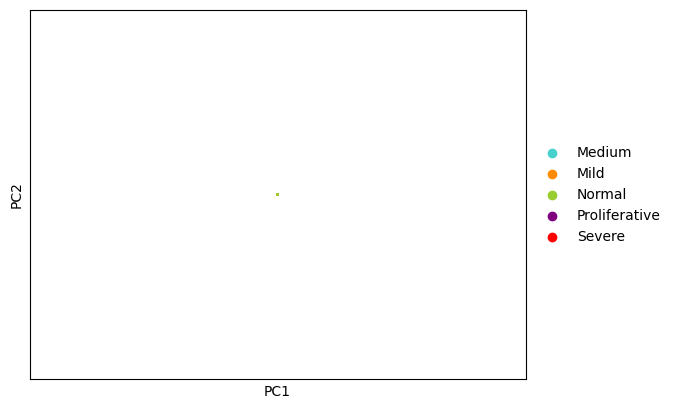

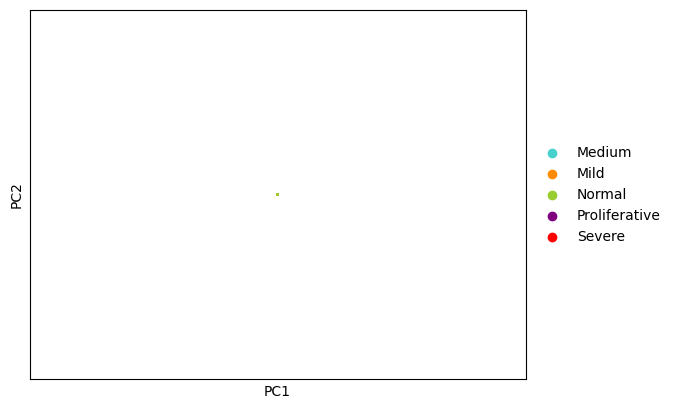

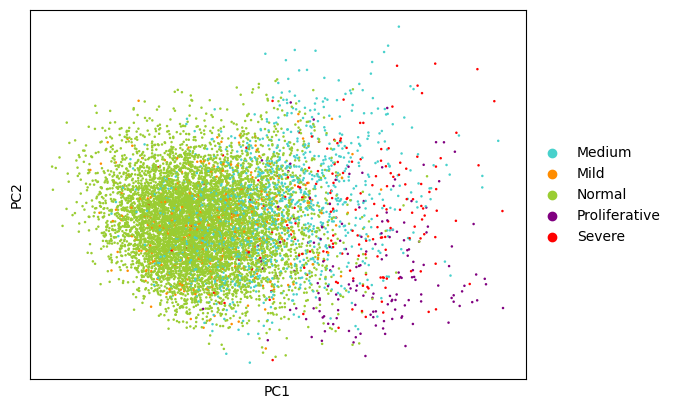

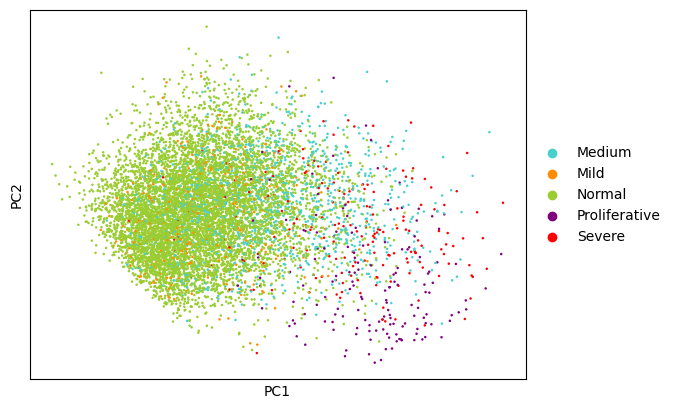

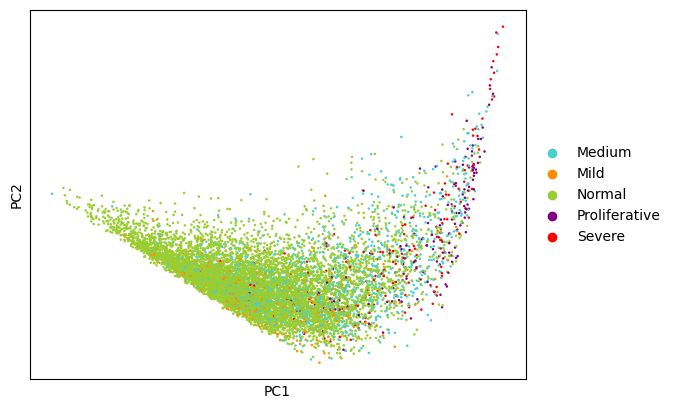

...

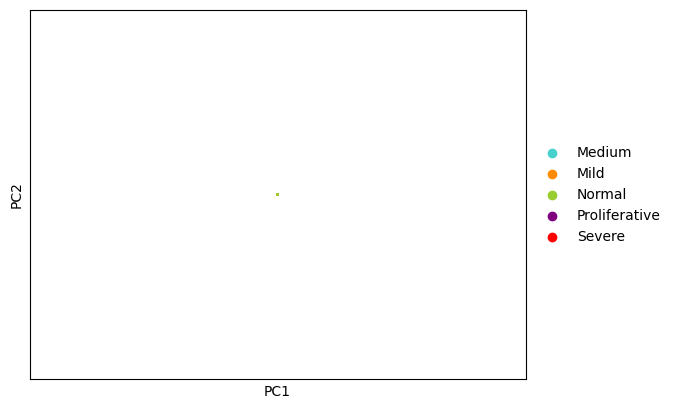

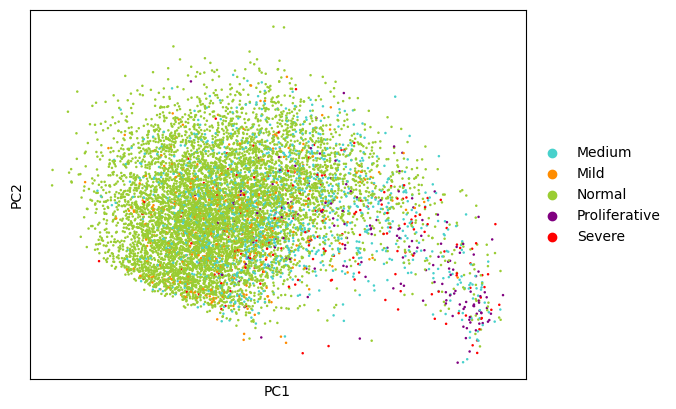

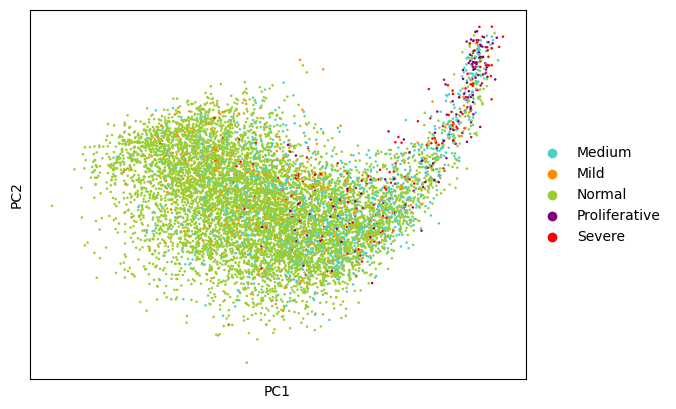

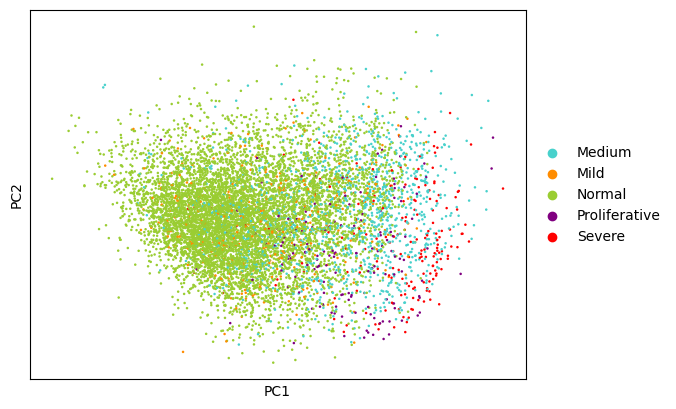

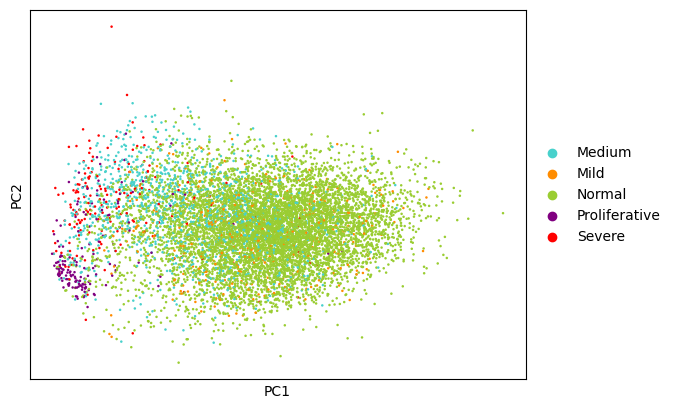

In [93]:
import os

for key in adata_dicts.keys():
    print("________________________________________________")
    print(key)
    filepath = Path("plots") / "all" / key
    os.makedirs(filepath, exist_ok=True)
    adata = show_adata(adata_dicts[key], filepath=filepath)
    print("________________________________________________")

________________________________________________


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/9194 [00:00<?, ?cell/s]

________________________________________________
________________________________________________


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/9194 [00:00<?, ?cell/s]

________________________________________________
________________________________________________


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/9194 [00:00<?, ?cell/s]

________________________________________________
________________________________________________


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/9194 [00:00<?, ?cell/s]

________________________________________________
________________________________________________


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/9194 [00:00<?, ?cell/s]

________________________________________________
________________________________________________


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/9194 [00:00<?, ?cell/s]

________________________________________________
________________________________________________


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/9194 [00:00<?, ?cell/s]

________________________________________________
________________________________________________


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/9194 [00:00<?, ?cell/s]

________________________________________________
________________________________________________


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/9194 [00:00<?, ?cell/s]

________________________________________________
________________________________________________


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/9194 [00:00<?, ?cell/s]

________________________________________________
________________________________________________


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/9194 [00:00<?, ?cell/s]

________________________________________________
________________________________________________


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/9194 [00:00<?, ?cell/s]

________________________________________________
________________________________________________


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/9194 [00:00<?, ?cell/s]

________________________________________________
________________________________________________


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/9194 [00:00<?, ?cell/s]

________________________________________________


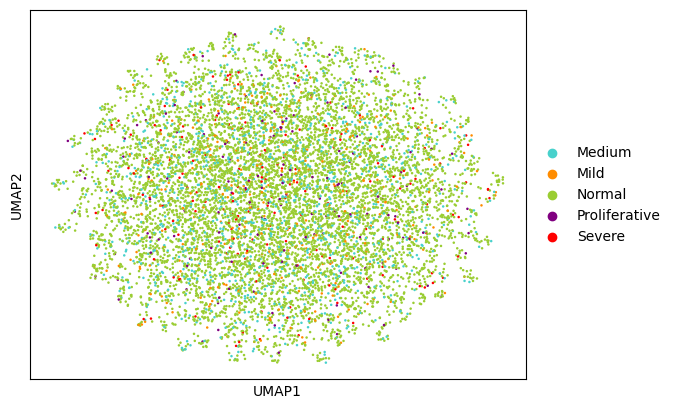

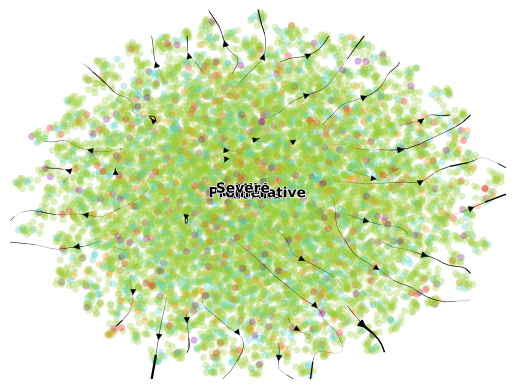

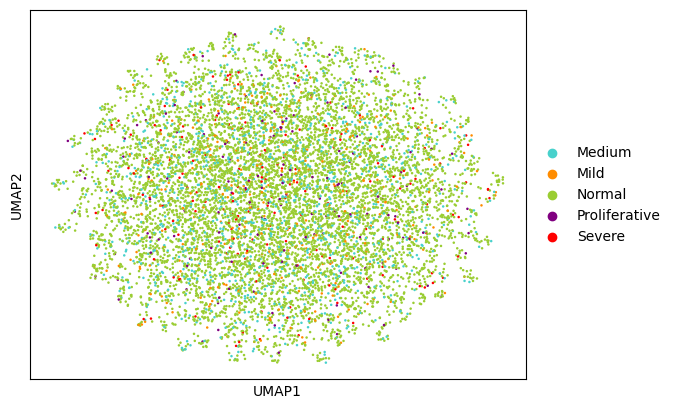

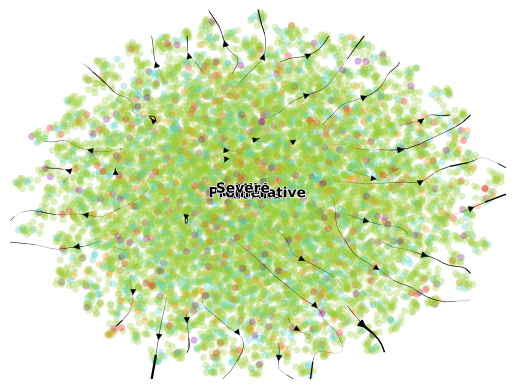

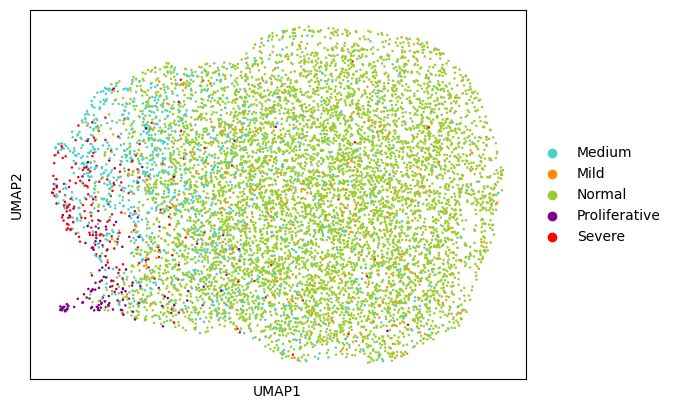

...

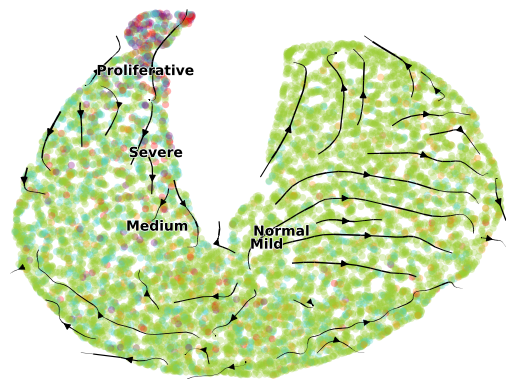

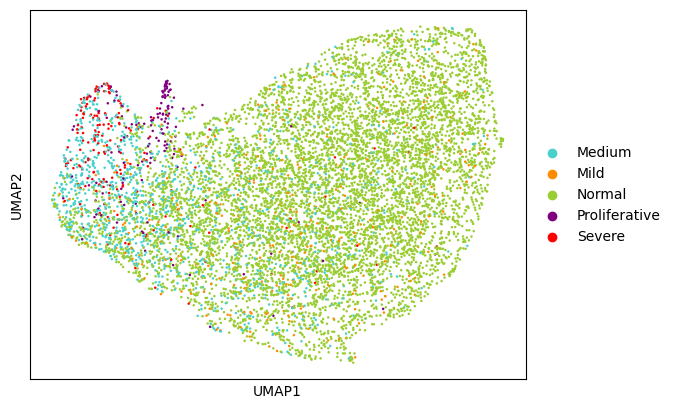

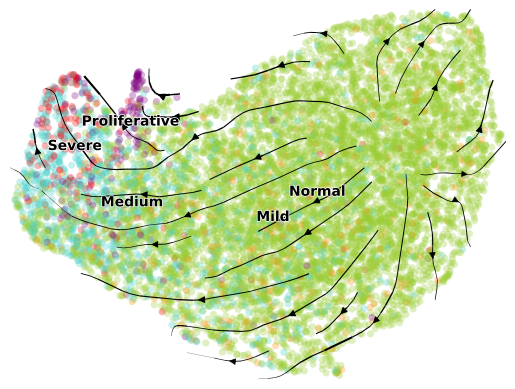

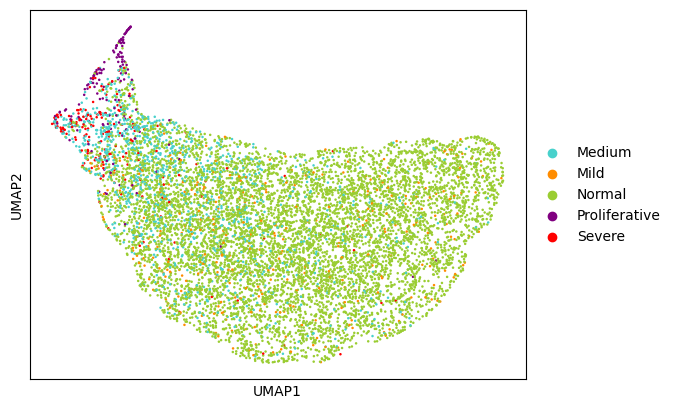

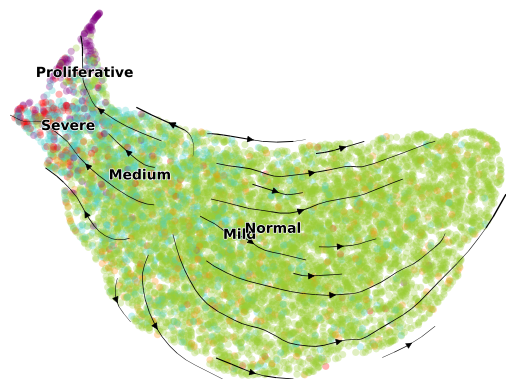

In [94]:
for key in adata_dicts.keys():
    print("________________________________________________")
    filepath = Path("plots") / "all" / key
    os.makedirs(filepath, exist_ok=True)
    show_adata_nonstandart(adata_dicts[key], filepath=filepath)
    print("________________________________________________")

In [95]:
def get_undersampled_adata(df):
    val_counts = pd.DataFrame(df.gt_class_decoded.value_counts())
    min_size = val_counts["count"].min()
    undersampled = []
    for name, group in df.groupby("gt_class_decoded"):
        if group.shape[0] > min_size:
            undersampled.append(group.sample(min_size))
        else:
            undersampled.append(group)
    undersampled_df = pd.concat(undersampled, ignore_index=True)
    return undersampled_df


import tempfile


def get_adata_from_df(df, columns_obs_only, index_column):
    with tempfile.NamedTemporaryFile(mode="w", suffix=".csv") as temp:
        df.to_csv(temp.name, index=False)
        temp.seek(0)
        adata = ep.io.read_csv(
            temp.name, index_column=index_column, columns_obs_only=columns_obs_only
        )
        temp_filepath = temp.name
        temp.close()
    return adata

In [101]:
adata_dicts_wo_proliferative = {}
ignored_models = [
    "resnet18ActBasedFC-version0",
    "resnet18RawFC-version0",
    "resnet18ImgNetFC-version0",
]

for i, row in experiments_pd.iterrows():
    filepath = RESULTS_DIR / row.model_name / "latents" / row.ckptn / "latents-test.csv"
    if filepath.exists() and row.model_name not in ignored_models:

        columns_obs_only_ = ["gt_class", "gt_class_decoded"]
        id_col = "id"
        df = pd.read_csv(str(filepath))
        df = df[df.gt_class_decoded != "Proliferative"]

        adata_dicts_wo_proliferative[f"{row.experiment}"] = get_adata_from_df(
            df, index_column=id_col, columns_obs_only=columns_obs_only_
        )

    # print()
    else:
        print(filepath.exists(), filepath)

2023-06-17 20:41:33,282 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `9036` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:41:33,712 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `9036` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:41:34,413 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `9036` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:41:35,123 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `9036` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:41:35,777 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `9036` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:41:36,399 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `9036` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:41:37,064 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `9036` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:41:37,731 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `9036` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:41:38,195 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `9036` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:41:38,652 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `9036` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


True /dss/dsshome1/02/di93zov/Projects/ehrapy_DR_latents/ehrapy_latents/project_folder/results/resnet18ImgNetFC-version0/latents/last/latents-test.csv
True /dss/dsshome1/02/di93zov/Projects/ehrapy_DR_latents/ehrapy_latents/project_folder/results/resnet18ImgNetFC-version0/latents/best/latents-test.csv
True /dss/dsshome1/02/di93zov/Projects/ehrapy_DR_latents/ehrapy_latents/project_folder/results/resnet18RawFC-version0/latents/last/latents-test.csv
True /dss/dsshome1/02/di93zov/Projects/ehrapy_DR_latents/ehrapy_latents/project_folder/results/resnet18RawFC-version0/latents/best/latents-test.csv
True /dss/dsshome1/02/di93zov/Projects/ehrapy_DR_latents/ehrapy_latents/project_folder/results/resnet18ActBasedFC-version0/latents/last/latents-test.csv
True /dss/dsshome1/02/di93zov/Projects/ehrapy_DR_latents/ehrapy_latents/project_folder/results/resnet18ActBasedFC-version0/latents/best/latents-test.csv
2023-06-17 20:41:39,262 - root INFO - Transformed passed dataframe into an AnnData object with n

/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:41:39,882 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `9036` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:41:40,536 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `9036` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:41:41,199 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `9036` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


________________________________________________
resnet18ActBasedFC-version3-last
plots/all_wo_proliferative/resnet18ActBasedFC-version3-last
gt_class_decoded
Normal    7294
Medium    1198
Mild       360
Severe     184
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/9036 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18ActBasedFC-version3-best
plots/all_wo_proliferative/resnet18ActBasedFC-version3-best
gt_class_decoded
Normal    7294
Medium    1198
Mild       360
Severe     184
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/9036 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet50KaggleFC-version0-last
plots/all_wo_proliferative/resnet50KaggleFC-version0-last
gt_class_decoded
Normal    7294
Medium    1198
Mild       360
Severe     184
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/9036 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet50KaggleFC-version0-best
plots/all_wo_proliferative/resnet50KaggleFC-version0-best
gt_class_decoded
Normal    7294
Medium    1198
Mild       360
Severe     184
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/9036 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18ActBasedFC-version1-last
plots/all_wo_proliferative/resnet18ActBasedFC-version1-last
gt_class_decoded
Normal    7294
Medium    1198
Mild       360
Severe     184
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/9036 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18ActBasedFC-version1-best
plots/all_wo_proliferative/resnet18ActBasedFC-version1-best
gt_class_decoded
Normal    7294
Medium    1198
Mild       360
Severe     184
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/9036 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18ImgNetFC-version2-last
plots/all_wo_proliferative/resnet18ImgNetFC-version2-last
gt_class_decoded
Normal    7294
Medium    1198
Mild       360
Severe     184
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/9036 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18ImgNetFC-version2-best
plots/all_wo_proliferative/resnet18ImgNetFC-version2-best
gt_class_decoded
Normal    7294
Medium    1198
Mild       360
Severe     184
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/9036 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18RawFC-version2-last
plots/all_wo_proliferative/resnet18RawFC-version2-last
gt_class_decoded
Normal    7294
Medium    1198
Mild       360
Severe     184
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/9036 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18RawFC-version2-best
plots/all_wo_proliferative/resnet18RawFC-version2-best
gt_class_decoded
Normal    7294
Medium    1198
Mild       360
Severe     184
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/9036 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18RawFC-version1-last
plots/all_wo_proliferative/resnet18RawFC-version1-last
gt_class_decoded
Normal    7294
Medium    1198
Mild       360
Severe     184
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/9036 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18RawFC-version1-best
plots/all_wo_proliferative/resnet18RawFC-version1-best
gt_class_decoded
Normal    7294
Medium    1198
Mild       360
Severe     184
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/9036 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18ImgNetFC-version3-last
plots/all_wo_proliferative/resnet18ImgNetFC-version3-last
gt_class_decoded
Normal    7294
Medium    1198
Mild       360
Severe     184
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/9036 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18ImgNetFC-version3-best
plots/all_wo_proliferative/resnet18ImgNetFC-version3-best
gt_class_decoded
Normal    7294
Medium    1198
Mild       360
Severe     184
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/9036 [00:00<?, ?cell/s]

________________________________________________


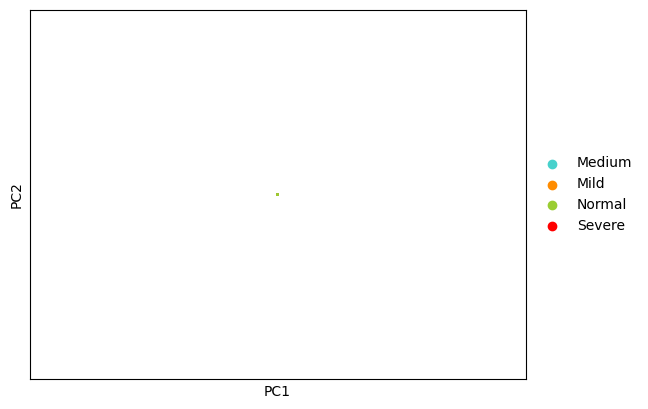

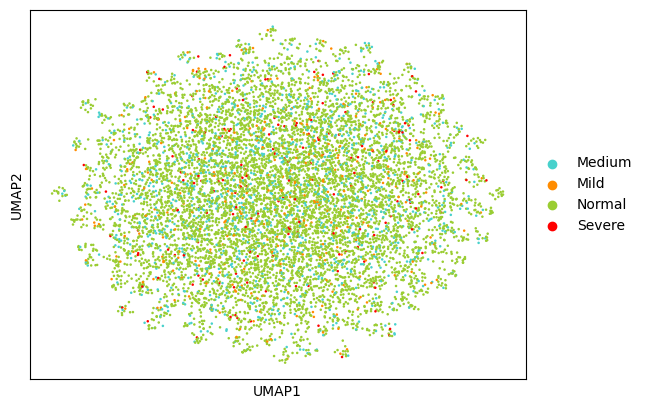

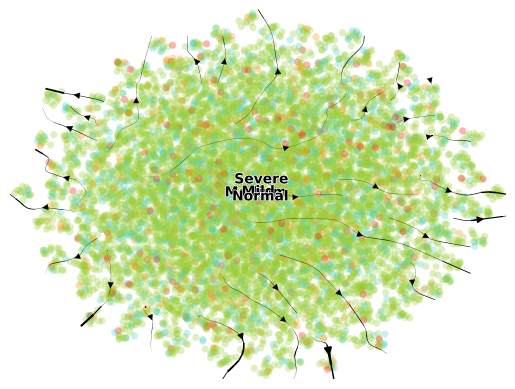

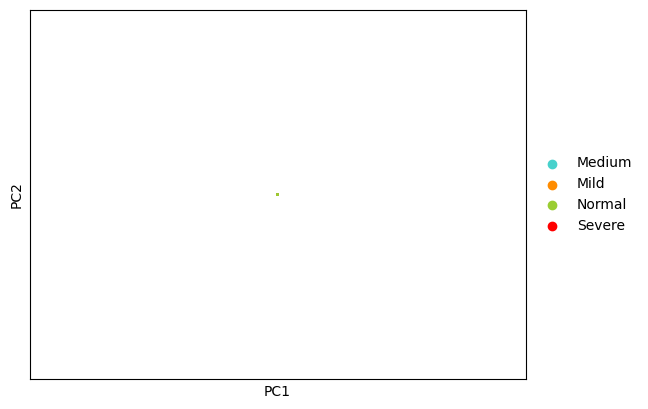

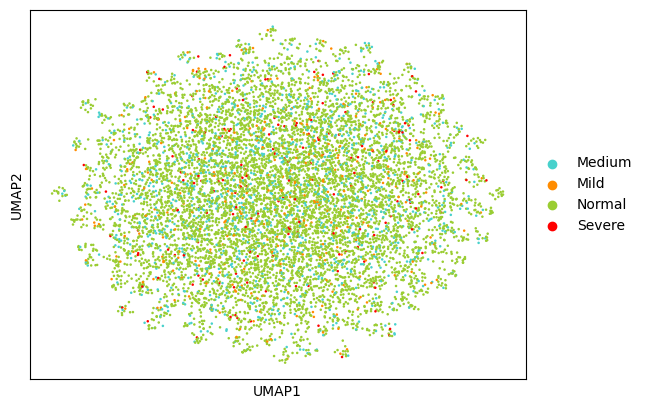

...

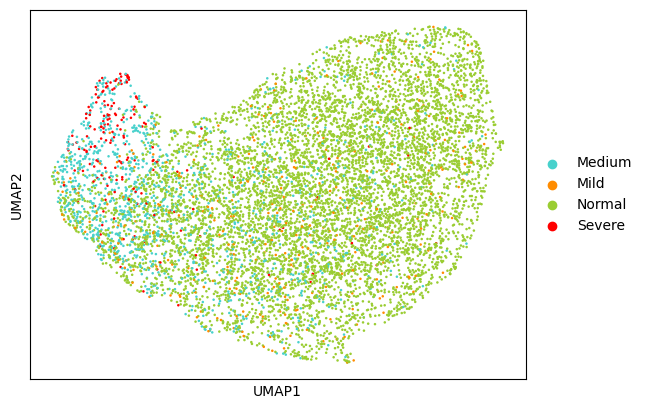

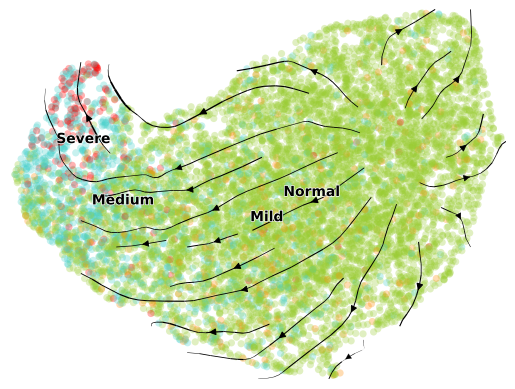

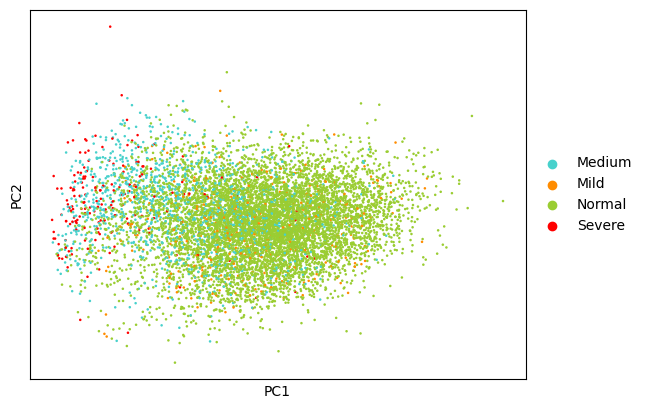

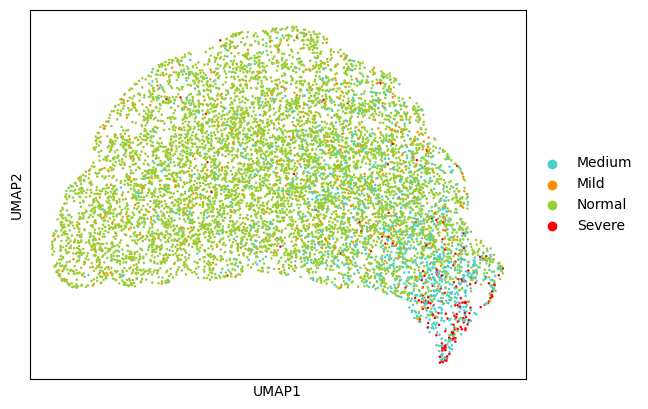

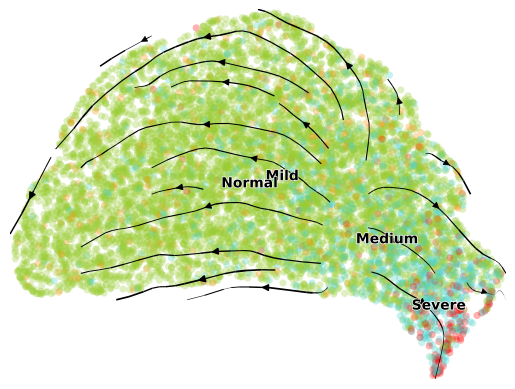

In [102]:
for key in adata_undesampled_dicts_wo_proliferative.keys():
    print("________________________________________________")
    print(key)
    filepath = Path("plots") / "all_wo_proliferative" / key
    os.makedirs(filepath)
    print(filepath)
    show_adata(adata_dicts_wo_proliferative[key], filepath=filepath)
    show_adata_nonstandart(adata_dicts_wo_proliferative[key], filepath=filepath)
    print("________________________________________________")

In [96]:
adata_undesampled_dicts = {}
ignored_models = [
    "resnet18ActBasedFC-version0",
    "resnet18RawFC-version0",
    "resnet18ImgNetFC-version0",
]

for i, row in experiments_pd.iterrows():
    filepath = RESULTS_DIR / row.model_name / "latents" / row.ckptn / "latents-test.csv"
    if filepath.exists() and row.model_name not in ignored_models:

        columns_obs_only_ = ["gt_class", "gt_class_decoded"]
        id_col = "id"

        df = pd.read_csv(str(filepath))
        df_undersampled = get_undersampled_adata(df)

        adata_undesampled_dicts[f"{row.experiment}"] = get_adata_from_df(
            df_undersampled, index_column=id_col, columns_obs_only=columns_obs_only_
        )

2023-06-17 20:35:46,285 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `790` x `64`.
2023-06-17 20:35:46,411 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `790` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:35:46,588 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `790` x `64`.
2023-06-17 20:35:46,761 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `790` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:35:46,927 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `790` x `64`.
2023-06-17 20:35:47,088 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `790` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:35:47,256 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `790` x `64`.
2023-06-17 20:35:47,416 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `790` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:35:47,531 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `790` x `64`.
2023-06-17 20:35:47,647 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `790` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:35:47,794 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `790` x `64`.
2023-06-17 20:35:47,937 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `790` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:35:48,088 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `790` x `64`.
2023-06-17 20:35:48,242 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `790` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


________________________________________________
resnet18ActBasedFC-version3-last
plots/balanced_undersampled/resnet18ActBasedFC-version3-last
gt_class_decoded
Medium           158
Mild             158
Normal           158
Proliferative    158
Severe           158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


________________________________________________
________________________________________________
resnet18ActBasedFC-version3-best
plots/balanced_undersampled/resnet18ActBasedFC-version3-best
gt_class_decoded
Medium           158
Mild             158
Normal           158
Proliferative    158
Severe           158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


________________________________________________
________________________________________________
resnet50KaggleFC-version0-last
plots/balanced_undersampled/resnet50KaggleFC-version0-last
gt_class_decoded
Medium           158
Mild             158
Normal           158
Proliferative    158
Severe           158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


________________________________________________
________________________________________________
resnet50KaggleFC-version0-best
plots/balanced_undersampled/resnet50KaggleFC-version0-best
gt_class_decoded
Medium           158
Mild             158
Normal           158
Proliferative    158
Severe           158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


________________________________________________
________________________________________________
resnet18ActBasedFC-version1-last
plots/balanced_undersampled/resnet18ActBasedFC-version1-last
gt_class_decoded
Medium           158
Mild             158
Normal           158
Proliferative    158
Severe           158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


________________________________________________
________________________________________________
resnet18ActBasedFC-version1-best
plots/balanced_undersampled/resnet18ActBasedFC-version1-best
gt_class_decoded
Medium           158
Mild             158
Normal           158
Proliferative    158
Severe           158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


________________________________________________
________________________________________________
resnet18ImgNetFC-version2-last
plots/balanced_undersampled/resnet18ImgNetFC-version2-last
gt_class_decoded
Medium           158
Mild             158
Normal           158
Proliferative    158
Severe           158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


________________________________________________
________________________________________________
resnet18ImgNetFC-version2-best
plots/balanced_undersampled/resnet18ImgNetFC-version2-best
gt_class_decoded
Medium           158
Mild             158
Normal           158
Proliferative    158
Severe           158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


________________________________________________
________________________________________________
resnet18RawFC-version2-last
plots/balanced_undersampled/resnet18RawFC-version2-last
gt_class_decoded
Medium           158
Mild             158
Normal           158
Proliferative    158
Severe           158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


________________________________________________
________________________________________________
resnet18RawFC-version2-best
plots/balanced_undersampled/resnet18RawFC-version2-best
gt_class_decoded
Medium           158
Mild             158
Normal           158
Proliferative    158
Severe           158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


________________________________________________
________________________________________________
resnet18RawFC-version1-last
plots/balanced_undersampled/resnet18RawFC-version1-last
gt_class_decoded
Medium           158
Mild             158
Normal           158
Proliferative    158
Severe           158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


________________________________________________
________________________________________________
resnet18RawFC-version1-best
plots/balanced_undersampled/resnet18RawFC-version1-best
gt_class_decoded
Medium           158
Mild             158
Normal           158
Proliferative    158
Severe           158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


________________________________________________
________________________________________________
resnet18ImgNetFC-version3-last
plots/balanced_undersampled/resnet18ImgNetFC-version3-last
gt_class_decoded
Medium           158
Mild             158
Normal           158
Proliferative    158
Severe           158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


________________________________________________
________________________________________________
resnet18ImgNetFC-version3-best
plots/balanced_undersampled/resnet18ImgNetFC-version3-best
gt_class_decoded
Medium           158
Mild             158
Normal           158
Proliferative    158
Severe           158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


________________________________________________


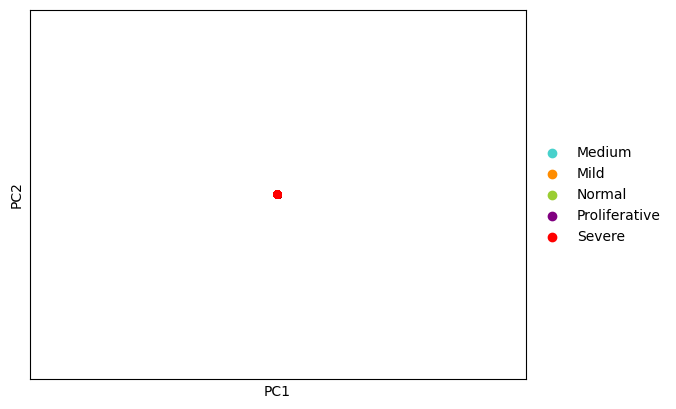

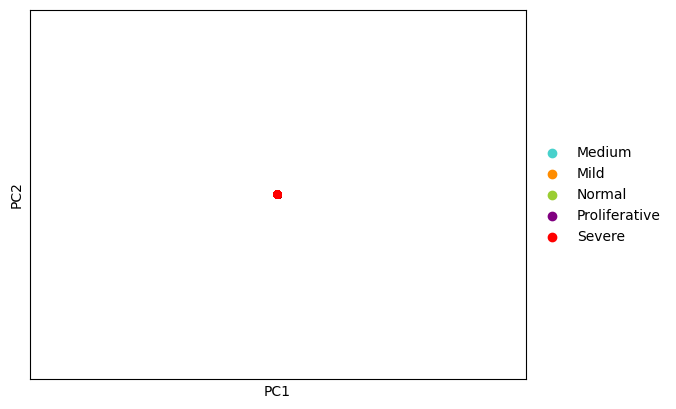

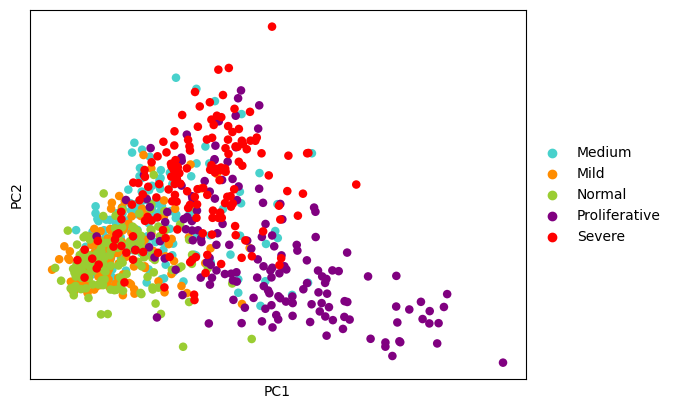

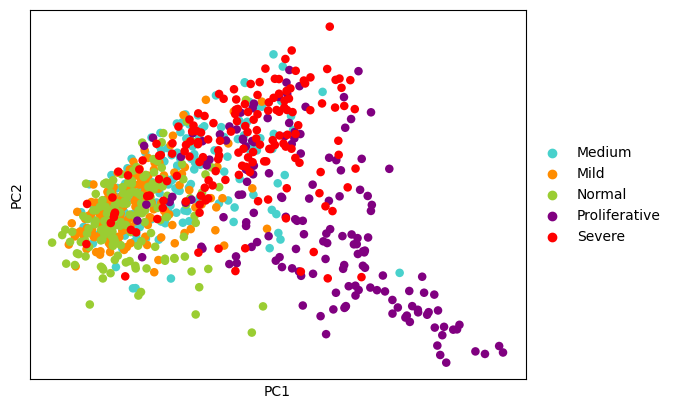

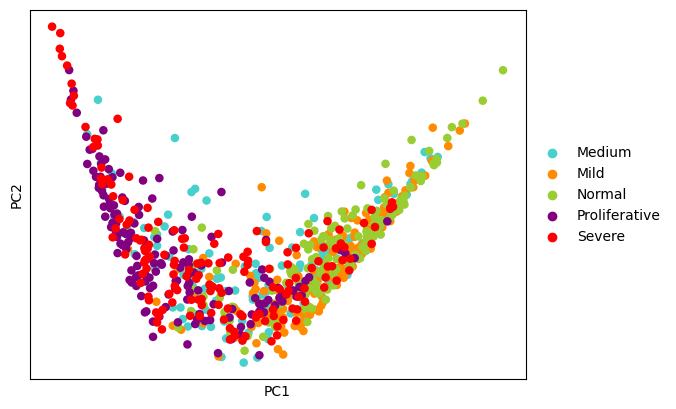

...

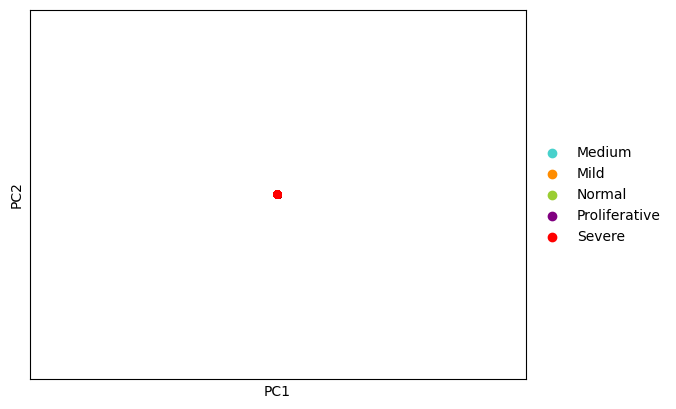

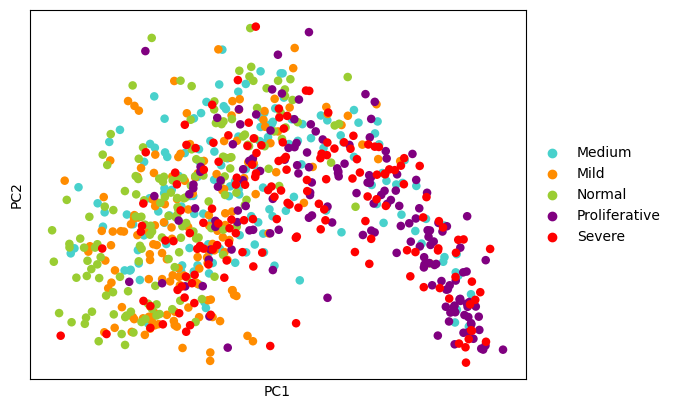

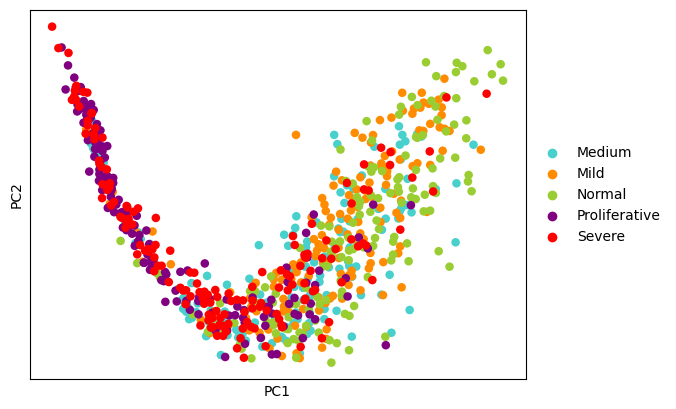

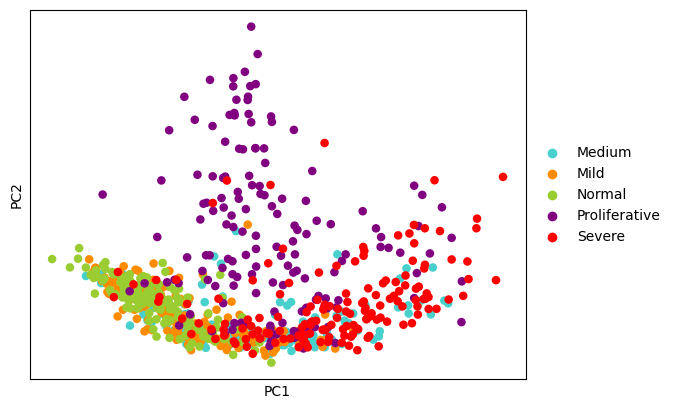

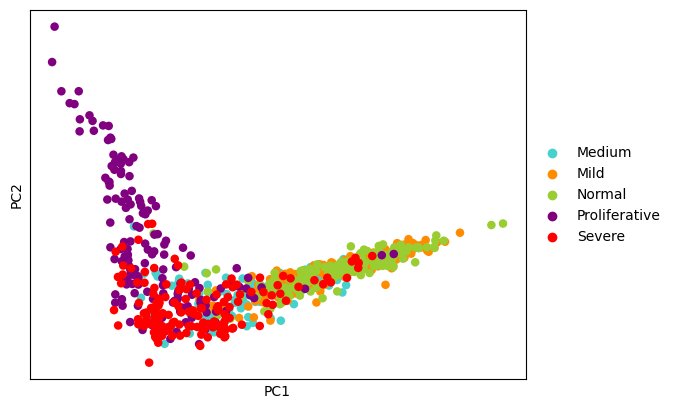

In [97]:
for key in adata_undesampled_dicts.keys():
    print("________________________________________________")
    print(key)
    filepath = Path("plots") / "balanced_undersampled" / key
    print(filepath)
    os.makedirs(filepath, exist_ok=True)
    adata = show_adata(adata_undesampled_dicts[key], filepath=filepath)
    print("________________________________________________")

________________________________________________
resnet18ActBasedFC-version3-last
plots/balanced_undersampled/resnet18ActBasedFC-version3-last


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/790 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18ActBasedFC-version3-best
plots/balanced_undersampled/resnet18ActBasedFC-version3-best


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/790 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet50KaggleFC-version0-last
plots/balanced_undersampled/resnet50KaggleFC-version0-last


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/790 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet50KaggleFC-version0-best
plots/balanced_undersampled/resnet50KaggleFC-version0-best


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/790 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18ActBasedFC-version1-last
plots/balanced_undersampled/resnet18ActBasedFC-version1-last


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/790 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18ActBasedFC-version1-best
plots/balanced_undersampled/resnet18ActBasedFC-version1-best


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/790 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18ImgNetFC-version2-last
plots/balanced_undersampled/resnet18ImgNetFC-version2-last


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/790 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18ImgNetFC-version2-best
plots/balanced_undersampled/resnet18ImgNetFC-version2-best


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/790 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18RawFC-version2-last
plots/balanced_undersampled/resnet18RawFC-version2-last


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/790 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18RawFC-version2-best
plots/balanced_undersampled/resnet18RawFC-version2-best


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/790 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18RawFC-version1-last
plots/balanced_undersampled/resnet18RawFC-version1-last


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/790 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18RawFC-version1-best
plots/balanced_undersampled/resnet18RawFC-version1-best


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/790 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18ImgNetFC-version3-last
plots/balanced_undersampled/resnet18ImgNetFC-version3-last


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/790 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18ImgNetFC-version3-best
plots/balanced_undersampled/resnet18ImgNetFC-version3-best


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/790 [00:00<?, ?cell/s]

________________________________________________


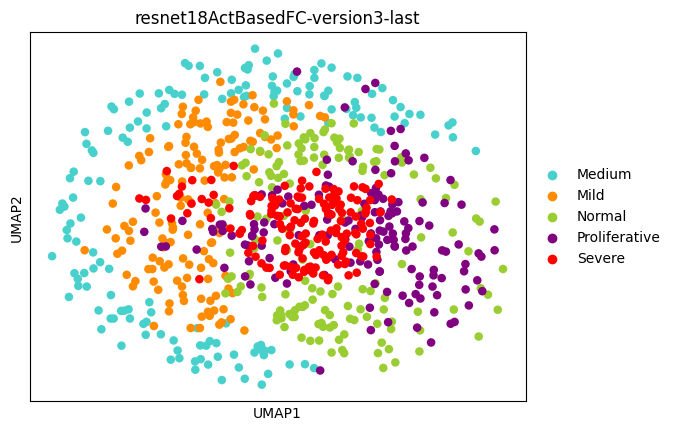

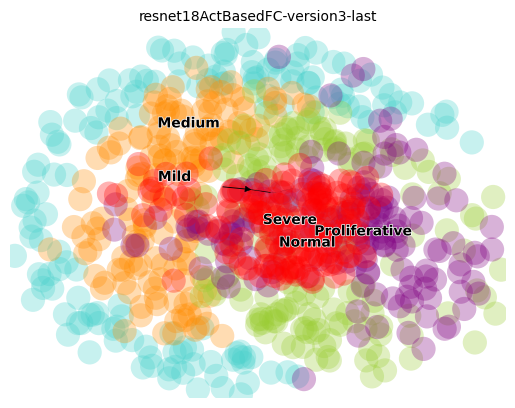

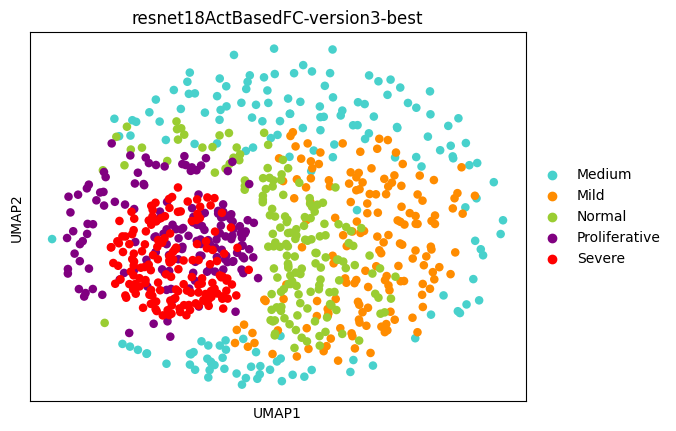

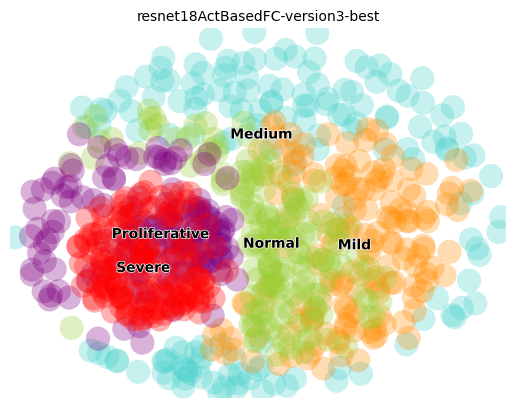

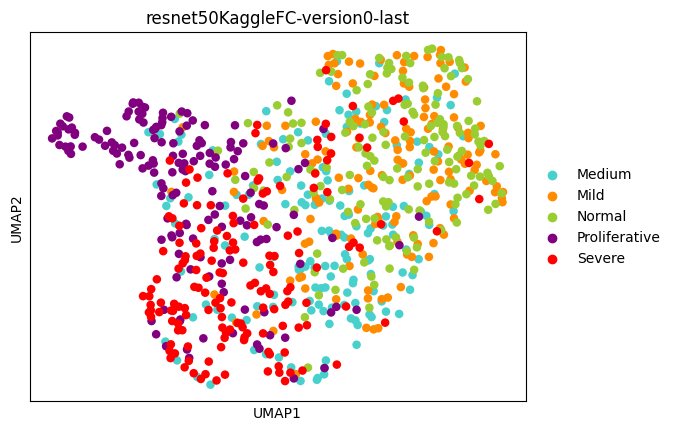

...

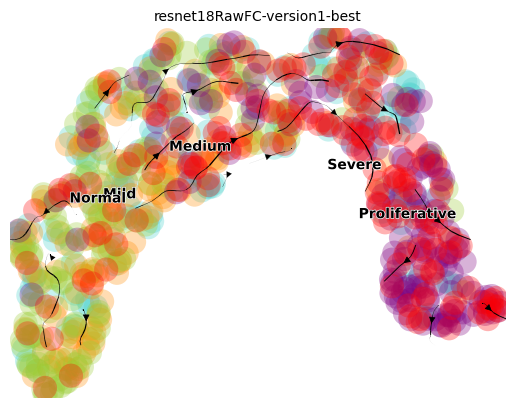

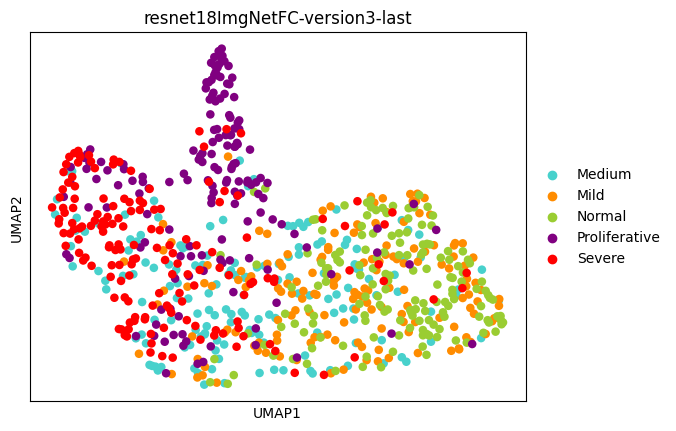

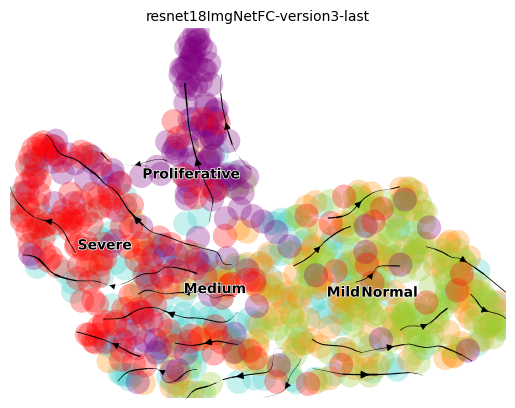

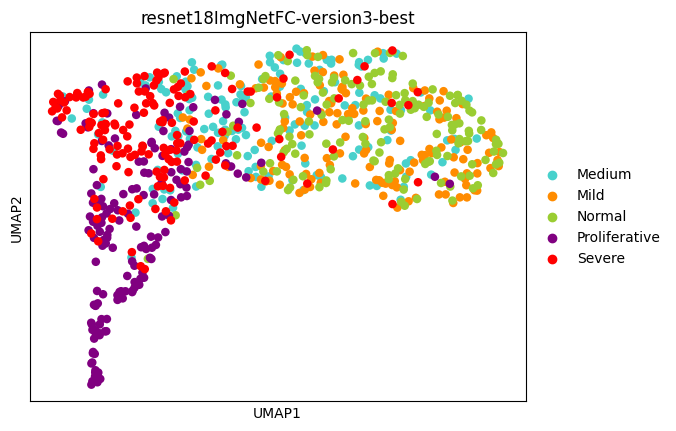

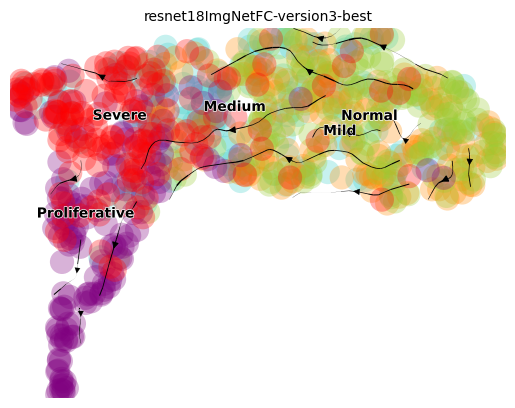

In [98]:
for key in adata_undesampled_dicts.keys():
    print("________________________________________________")
    print(key)
    filepath = Path("plots") / "balanced_undersampled" / key
    print(filepath)
    show_adata_nonstandart(adata_undesampled_dicts[key], title=key, filepath=filepath)

    print("________________________________________________")

In [99]:
ignored_models = [
    "resnet18ActBasedFC-version0",
    "resnet18RawFC-version0",
    "resnet18ImgNetFC-version0",
]

adata_undesampled_dicts_wo_proliferative = {}
for i, row in experiments_pd.iterrows():
    filepath = RESULTS_DIR / row.model_name / "latents" / row.ckptn / "latents-test.csv"
    if filepath.exists() and row.model_name not in ignored_models:

        columns_obs_only_ = ["gt_class", "gt_class_decoded"]
        id_col = "id"

        df = pd.read_csv(str(filepath))
        df = df[df.gt_class_decoded != "Proliferative"]
        df_undersampled = get_undersampled_adata(df)

        adata_undesampled_dicts_wo_proliferative[
            f"{row.experiment}"
        ] = get_adata_from_df(
            df_undersampled, index_column=id_col, columns_obs_only=columns_obs_only_
        )

2023-06-17 20:38:44,751 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `736` x `64`.
2023-06-17 20:38:44,864 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `736` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:38:45,035 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `736` x `64`.
2023-06-17 20:38:45,199 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `736` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:38:45,358 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `736` x `64`.
2023-06-17 20:38:45,507 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `736` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:38:45,664 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `736` x `64`.
2023-06-17 20:38:45,814 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `736` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:38:45,928 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `736` x `64`.
2023-06-17 20:38:46,041 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `736` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:38:46,188 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `736` x `64`.
2023-06-17 20:38:46,332 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `736` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


2023-06-17 20:38:46,481 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `736` x `64`.
2023-06-17 20:38:46,631 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `736` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


________________________________________________
resnet18ActBasedFC-version3-last
plots/balanced_undersampled_wo_proliferative/resnet18ActBasedFC-version3-last
gt_class_decoded
Medium    184
Mild      184
Normal    184
Severe    184
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/736 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18ActBasedFC-version3-best
plots/balanced_undersampled_wo_proliferative/resnet18ActBasedFC-version3-best
gt_class_decoded
Medium    184
Mild      184
Normal    184
Severe    184
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/736 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet50KaggleFC-version0-last
plots/balanced_undersampled_wo_proliferative/resnet50KaggleFC-version0-last
gt_class_decoded
Medium    184
Mild      184
Normal    184
Severe    184
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/736 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet50KaggleFC-version0-best
plots/balanced_undersampled_wo_proliferative/resnet50KaggleFC-version0-best
gt_class_decoded
Medium    184
Mild      184
Normal    184
Severe    184
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/736 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18ActBasedFC-version1-last
plots/balanced_undersampled_wo_proliferative/resnet18ActBasedFC-version1-last
gt_class_decoded
Medium    184
Mild      184
Normal    184
Severe    184
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/736 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18ActBasedFC-version1-best
plots/balanced_undersampled_wo_proliferative/resnet18ActBasedFC-version1-best
gt_class_decoded
Medium    184
Mild      184
Normal    184
Severe    184
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/736 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18ImgNetFC-version2-last
plots/balanced_undersampled_wo_proliferative/resnet18ImgNetFC-version2-last
gt_class_decoded
Medium    184
Mild      184
Normal    184
Severe    184
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/736 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18ImgNetFC-version2-best
plots/balanced_undersampled_wo_proliferative/resnet18ImgNetFC-version2-best
gt_class_decoded
Medium    184
Mild      184
Normal    184
Severe    184
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/736 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18RawFC-version2-last
plots/balanced_undersampled_wo_proliferative/resnet18RawFC-version2-last
gt_class_decoded
Medium    184
Mild      184
Normal    184
Severe    184
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/736 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18RawFC-version2-best
plots/balanced_undersampled_wo_proliferative/resnet18RawFC-version2-best
gt_class_decoded
Medium    184
Mild      184
Normal    184
Severe    184
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/736 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18RawFC-version1-last
plots/balanced_undersampled_wo_proliferative/resnet18RawFC-version1-last
gt_class_decoded
Medium    184
Mild      184
Normal    184
Severe    184
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/736 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18RawFC-version1-best
plots/balanced_undersampled_wo_proliferative/resnet18RawFC-version1-best
gt_class_decoded
Medium    184
Mild      184
Normal    184
Severe    184
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/736 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18ImgNetFC-version3-last
plots/balanced_undersampled_wo_proliferative/resnet18ImgNetFC-version3-last
gt_class_decoded
Medium    184
Mild      184
Normal    184
Severe    184
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/736 [00:00<?, ?cell/s]

________________________________________________
________________________________________________
resnet18ImgNetFC-version3-best
plots/balanced_undersampled_wo_proliferative/resnet18ImgNetFC-version3-best
gt_class_decoded
Medium    184
Mild      184
Normal    184
Severe    184
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


  0%|          | 0/736 [00:00<?, ?cell/s]

________________________________________________


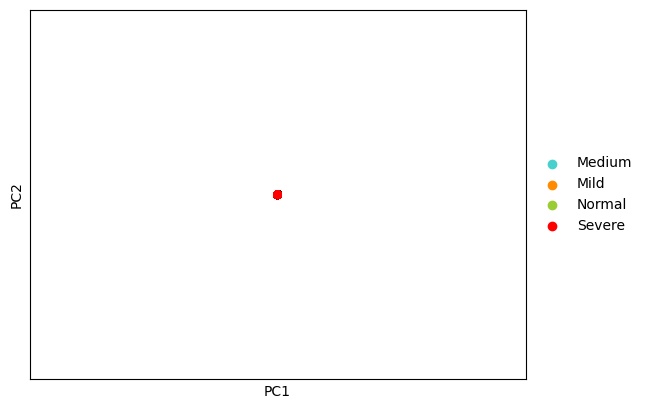

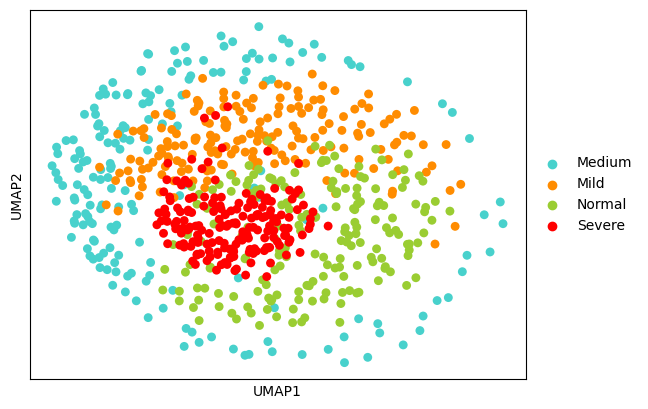

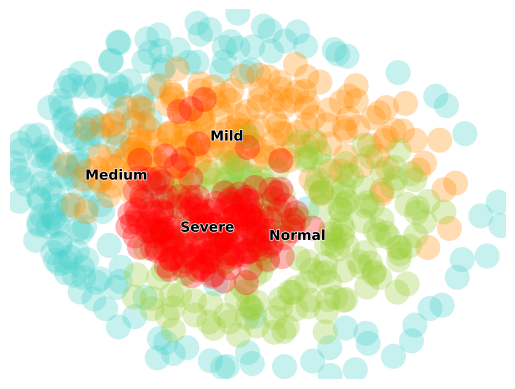

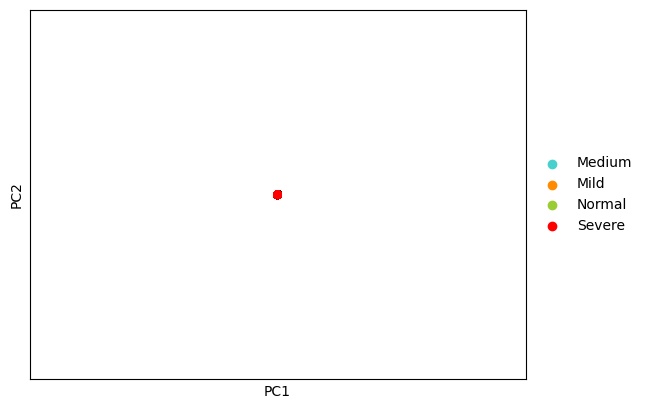

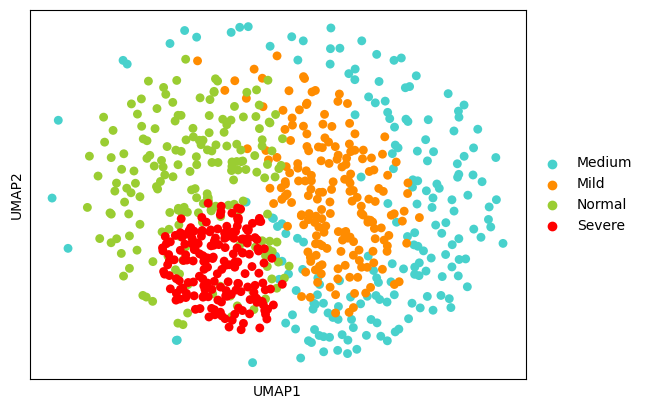

...

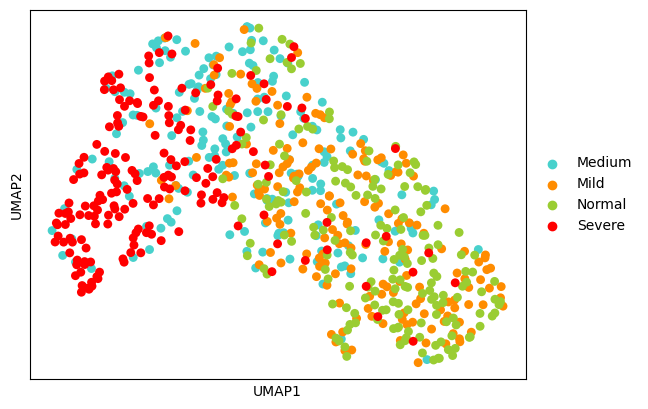

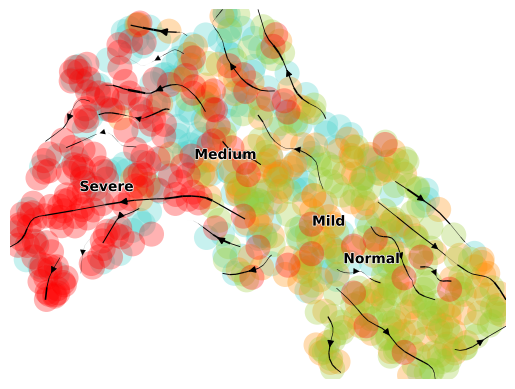

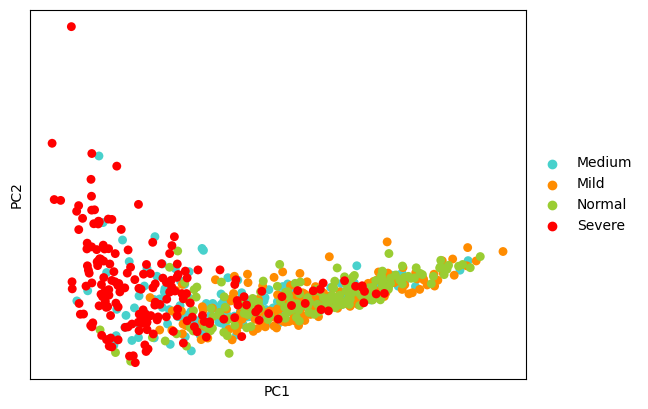

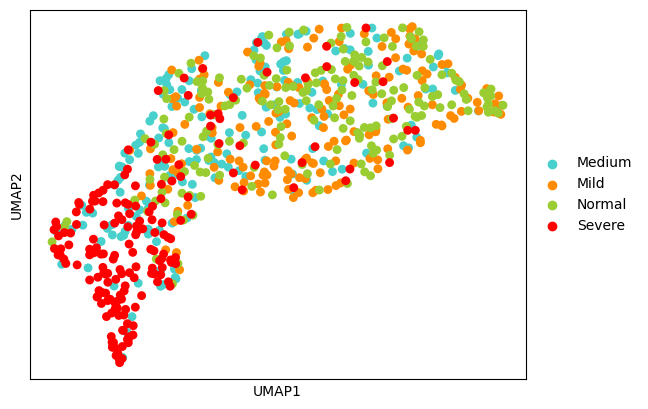

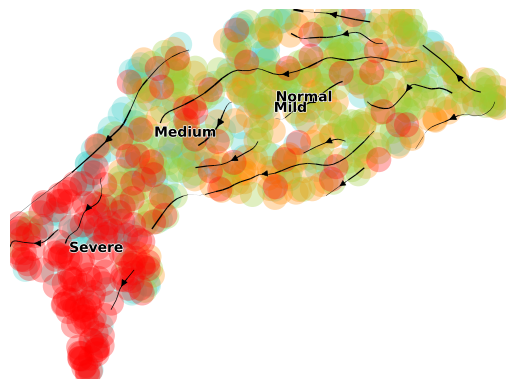

In [100]:
for key in adata_undesampled_dicts_wo_proliferative.keys():
    print("________________________________________________")
    print(key)
    filepath = Path("plots") / "balanced_undersampled_wo_proliferative" / key
    os.makedirs(filepath)
    print(filepath)
    show_adata(adata_undesampled_dicts_wo_proliferative[key], filepath=filepath)
    show_adata_nonstandart(
        adata_undesampled_dicts_wo_proliferative[key], filepath=filepath
    )
    print("________________________________________________")

In [103]:
key

'resnet18ImgNetFC-version3-best'

resnet18ImgNetFC-version2-best


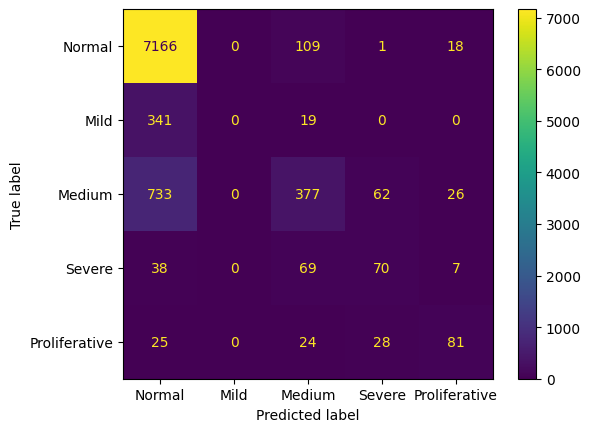

In [111]:
experiment_name = classification_results_ordered[
    classification_results_ordered["order_f1-score_macro avg"] == 0
].experiment.unique()[0]

# experiment_name= 'resnet18ImgNetFC-version3-last'
print(experiment_name)
preds = predictions[experiment_name]
labels = [
    el for el in label_map.values() if el in list(preds.gt_class_decoded.unique())
]
cm = confusion_matrix(
    preds.gt_class_decoded.values.ravel(),
    preds.predicted_class_decoded.values.ravel(),
    labels=labels,
)
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels).plot()

In [104]:
# experiment_name = classification_results_ordered[classification_results_ordered['order_f1-score_macro avg']==0].experiment.unique()[0]

experiment_name = "resnet18ImgNetFC-version3-best"
print(experiment_name)
preds = predictions[experiment_name]
labels = [
    el for el in label_map.values() if el in list(preds.gt_class_decoded.unique())
]
cm = confusion_matrix(
    preds.gt_class_decoded.values.ravel(),
    preds.predicted_class_decoded.values.ravel(),
    labels=labels,
)
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels).plot()

resnet18ImgNetFC-version3-best


KeyError: 'resnet18ImgNetFC-version3-best'

In [108]:
import scanpy as sc
import pandas as pd
import scvelo as scv
import cellrank as cr
import ehrapy as ep
import numpy as np
import matplotlib.pyplot as plt
import ehrapy as ep

Installed version 0.3.0 of ehrapy is outdated. Newest version is 0.4.0!

In [109]:
from ehrapylat.latent_extractors.predictors.utils import Stage, FinishCallback, NNModel
from ehrapylat.constants import MODELS_DIR, RESULTS_DIR
from ehrapylat.latent_extractors.predictors.models.LatentExtractor import (
    Models as SpatialSSLModels,
)

# from ehrapylat.latent_extractors.predictors.utils import Stage

In [110]:
palette = {
    "Normal": "yellowgreen",
    "Mild": "darkorange",
    "Medium": "mediumturquoise",
    "Severe": "red",
    "Proliferative": "purple",
}

In [114]:
adata_dicts = {}
model = "resnet18ImgNetFC-version2"
ckptn = "last"
filepath = RESULTS_DIR / model / "latents" / ckptn / "latents-test.csv"
columns_obs_only_ = ["gt_class", "gt_class_decoded"]
id_col = "id"

adata = ep.io.read_csv(
    filepath, index_column=id_col, columns_obs_only=columns_obs_only_
)
print(model)

2023-06-16 18:07:34,780 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `9194` x `64`.
resnet18ImgNetFC-version2


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


In [115]:
def show_adata(adata, palette=palette):
    print(adata.obs.gt_class_decoded.value_counts())
    ep.pp.pca(adata)
    ep.pp.neighbors(adata)

    # UMAP
    ep.tl.umap(adata)
    ep.pl.pca(adata, color=["gt_class_decoded"], palette=palette)
    ep.pl.umap(adata, color=["gt_class_decoded"], palette=palette)
    return adata

In [116]:
import numpy as np
from cellrank.tl.kernels import ConnectivityKernel
from cellrank.tl.kernels import PseudotimeKernel


def show_adata_nonstandart(adata, palette=palette):

    # ep.tl.leiden(adata)
    # ep.tl.paga(adata)
    # ep.pl.paga(adata)

    ep.pp.pca(adata)
    ep.pp.neighbors(adata)
    ep.tl.umap(adata)
    ep.pl.umap(adata, color="gt_class_decoded")

    adata.uns["iroot"] = np.flatnonzero(adata.obs["gt_class_decoded"] == "Normal")[10]
    ep.tl.dpt(adata)
    pk = PseudotimeKernel(adata)
    pk.compute_transition_matrix(threshold_scheme="soft")

    pk.compute_projection(basis="umap")
    scv.pl.velocity_embedding_stream(
        adata, vkey="T_fwd", basis="umap", color="gt_class_decoded", density=0.5
    )

________________________________________________
resnet18ImgNetFC-version2
gt_class_decoded
Normal           7294
Medium           1198
Mild              360
Severe            184
Proliferative     158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


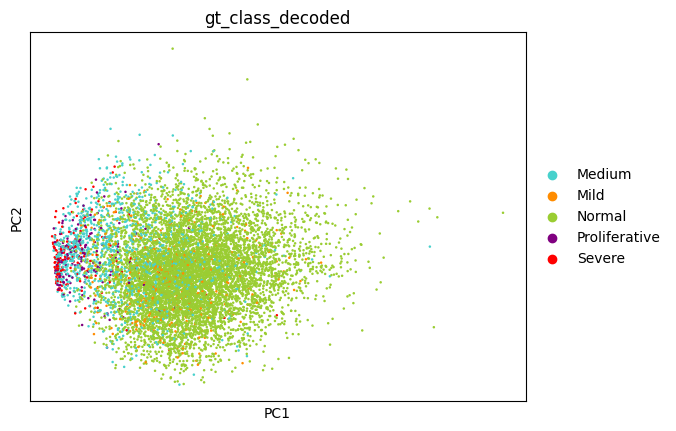

/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


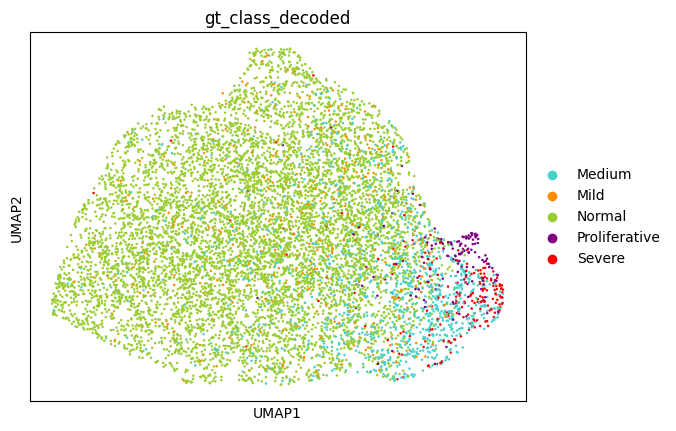

________________________________________________


In [118]:
print("________________________________________________")
print(model)
adata = show_adata(adata)
print("________________________________________________")

/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


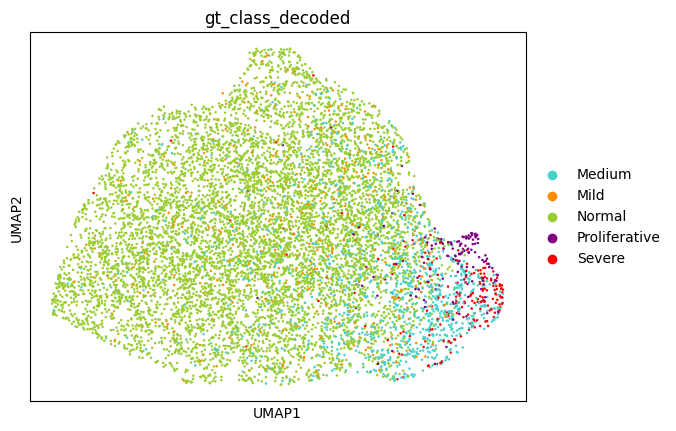

  0%|          | 0/9194 [00:00<?, ?cell/s]

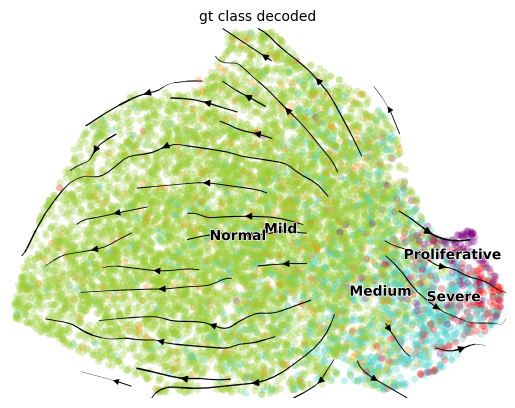

In [119]:
show_adata_nonstandart(adata)

In [120]:
def get_undersampled_adata(df):
    val_counts = pd.DataFrame(df.gt_class_decoded.value_counts())
    min_size = val_counts["count"].min()
    undersampled = []
    for name, group in df.groupby("gt_class_decoded"):
        if group.shape[0] > min_size:
            undersampled.append(group.sample(min_size))
        else:
            undersampled.append(group)
    undersampled_df = pd.concat(undersampled, ignore_index=True)
    return undersampled_df


import tempfile


def get_adata_from_df(df, columns_obs_only, index_column):
    with tempfile.NamedTemporaryFile(mode="w", suffix=".csv") as temp:
        df.to_csv(temp.name, index=False)
        temp.seek(0)
        adata = ep.io.read_csv(
            temp.name, index_column=index_column, columns_obs_only=columns_obs_only
        )
        temp_filepath = temp.name
        temp.close()
    return adata

In [121]:
filepath = RESULTS_DIR / model / "latents" / ckptn / "latents-test.csv"

df = pd.read_csv(str(filepath))
df_undersampled = get_undersampled_adata(df)
columns_obs_only_ = ["gt_class", "gt_class_decoded"]
id_col = "id"

adata_undesampled = get_adata_from_df(
    df_undersampled, index_column=id_col, columns_obs_only=columns_obs_only_
)

2023-06-16 18:10:45,713 - root INFO - Transformed passed dataframe into an AnnData object with n_obs x n_vars = `790` x `64`.


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/ehrapy/io/_read.py:504: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(initial_df[col])


________________________________________________
resnet18ImgNetFC-version2
gt_class_decoded
Medium           158
Mild             158
Normal           158
Proliferative    158
Severe           158
Name: count, dtype: int64


/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


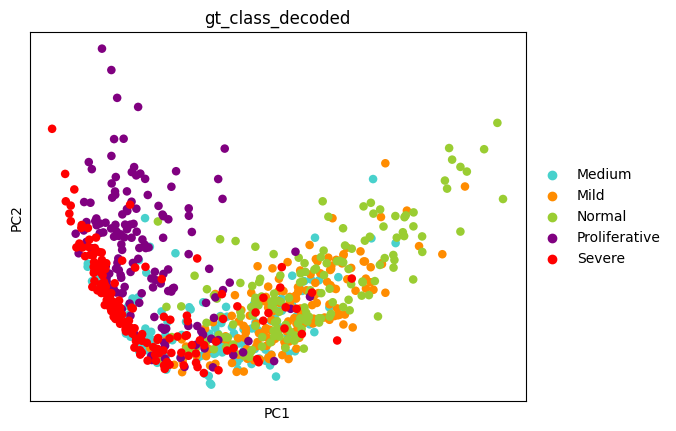

/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


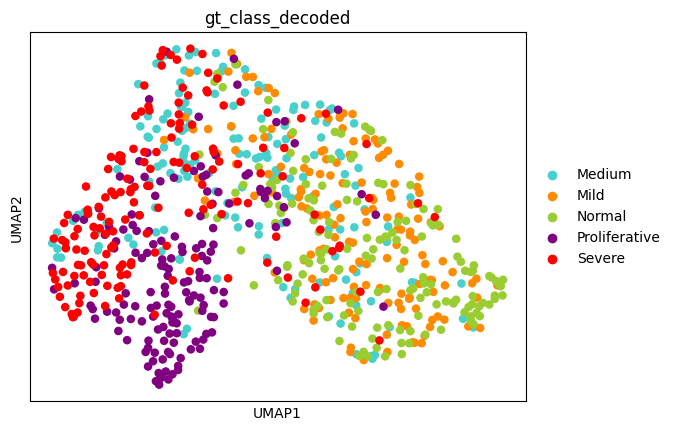

________________________________________________


In [123]:
print("________________________________________________")
print(model)
adata_undesampled = show_adata(adata_undesampled)
print("________________________________________________")

/dss/dsshome1/02/di93zov/anaconda3/envs/ehrapy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


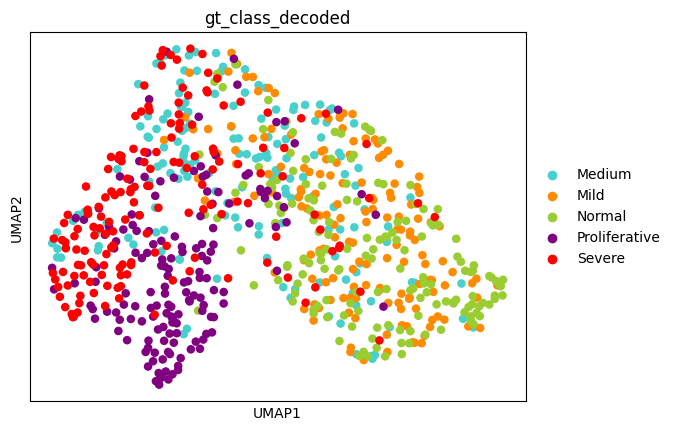

  0%|          | 0/790 [00:00<?, ?cell/s]

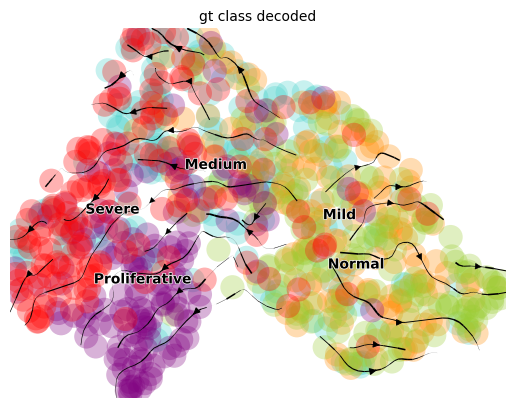

In [124]:
show_adata_nonstandart(adata_undesampled)